# Exercizes on clustering

Here you can find a program to read a data file in csv format. 
The data file has the following heading:
    number of samples, number of features
    list of the names of the features (separated by comma)
The remaining lines contain an example per row.
For each row there is a list of real numbers (commas separated) which are the feature values.   

In [45]:
import csv
import sys
from os.path import join

import numpy as np
 
# this function reads the data file, loads the configuration attributes specifiefd in the heading
# (numer of examples and features), the list of feature names
# and loads the data in a matrix named data    
def load_data(file_path, file_name):
   with open(join(file_path, file_name)) as csv_file:
       data_file = csv.reader(csv_file,delimiter=',')
       temp1 = next(data_file)
       n_samples = int(temp1[0])
       print("n_samples=")
       print(n_samples)
       n_features = int(temp1[1])
       temp2 = next(data_file)
       feature_names = np.array(temp2[:n_features])

       data_list = [iter for iter in data_file]
               
       data = np.asarray(data_list, dtype=np.float64)                  
       
   return(data,feature_names,n_samples,n_features)

# The main program reads the input file containing the dataset
# file_path is the file path where the file with the data to be read are located
# we assume the file contains an example per line
# each example is a list of real values separated by a comma (csv format)
# The first line of the file contains the heading with:
# N_samples,n_features,
# The second line contains the feature names separated by a comma     

#file_path="content/"
file_path="./Datasets"
# all the three datasets contain data points on (x,y) 
file_name1="3-clusters.csv"
file_name2="dataset-DBSCAN.csv"     
file_name3="CURE-complete.csv"    
data1,feature_names1,n_samples1,n_features1 = load_data(file_path, file_name1)
data2,feature_names2,n_samples2,n_features2 = load_data(file_path, file_name2)
data3,feature_names3,n_samples3,n_features3 = load_data(file_path, file_name3)
print("dataset n. 1: n samples, n features")
print(n_samples1, n_features1)
print("dataset n. 2: n samples, n features")
print(n_samples2, n_features2)
print("dataset n. 3: n samples, n features")
print(n_samples3, n_features3)

n_samples=
150
n_samples=
6118
n_samples=
86558
dataset n. 1: n samples, n features
150 2
dataset n. 2: n samples, n features
6118 2
dataset n. 3: n samples, n features
86558 2


The following program plots the dataset n.1

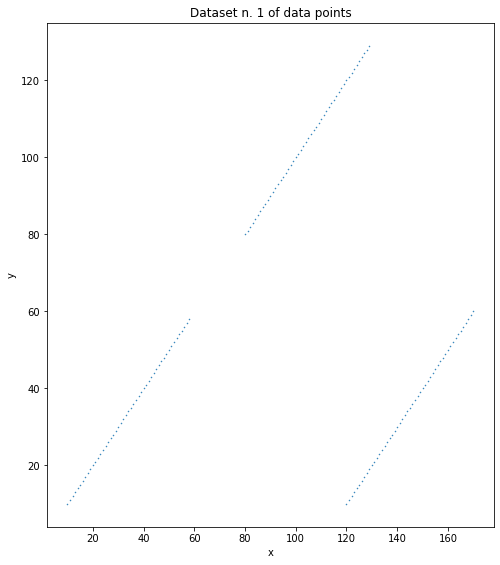

In [46]:
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(8,8))

ax = fig.add_subplot(111)
fig.subplots_adjust(top=1)
ax.set_title('Dataset n. 1 of data points')

ax.set_xlabel(feature_names1[0])
ax.set_ylabel(feature_names1[1])

#plot the dataset
plt.plot(data1[:,0], data1[:,1], '.',markersize=1)

plt.show()

The following is the program for plotting the dataset n.2

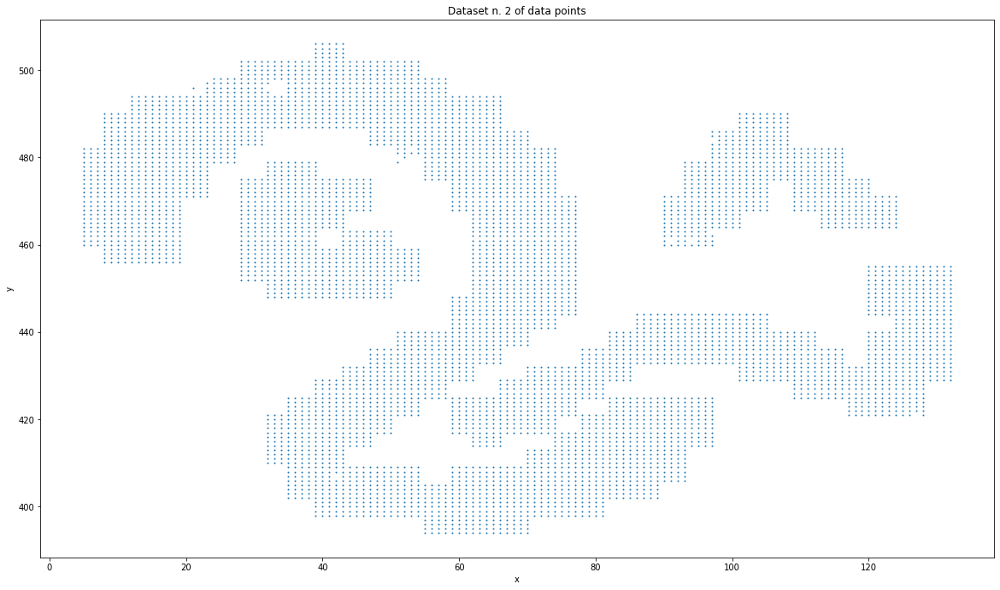

In [47]:
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(20,10))

ax = fig.add_subplot(111)
fig.subplots_adjust(top=1)
ax.set_title('Dataset n. 2 of data points')

ax.set_xlabel(feature_names2[0])
ax.set_ylabel(feature_names2[1])

#plot the dataset
plt.plot(data2[:,0], data2[:,1], '.', markersize=2)

plt.show()

The following is the program for plotting the dataset n.3

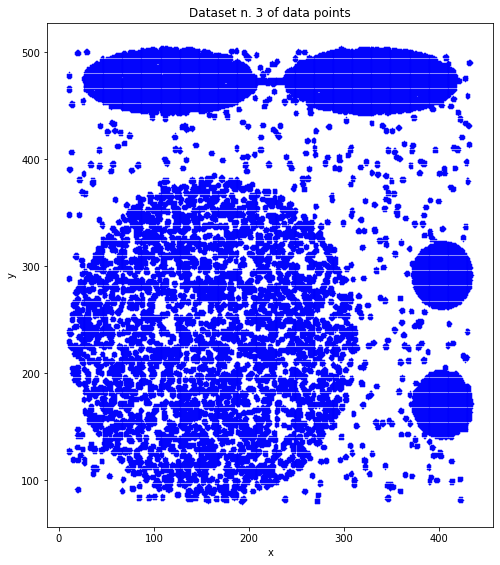

In [48]:
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(8,8))

ax = fig.add_subplot(111)
fig.subplots_adjust(top=1)
ax.set_title('Dataset n. 3 of data points')

ax.set_xlabel(feature_names3[0])
ax.set_ylabel(feature_names3[1])

#plot the dataset
plt.plot(data3[:,0], data3[:,1], '.', markersize=1.2, markeredgecolor = 'blue')

plt.show()

## In the following program we cluster the dataset n.1 with K-means. 
From the plot of dataset n.1 we see 3 separated clusters. Thus k=3. 

In [49]:
import csv
import sys
from os.path import join

import numpy as np
 
def load_data(file_path, file_name):
   with open(join(file_path, file_name)) as csv_file:
       data_file = csv.reader(csv_file,delimiter=',')
       temp1 = next(data_file)
       n_samples = int(temp1[0])
       n_features = int(temp1[1])
       temp2 = next(data_file)
       feature_names = np.array(temp2[:n_features])

       data_list = [iter for iter in data_file]
               
       data = np.asarray(data_list, dtype=np.float64)                  
       
   return(data,feature_names,n_samples,n_features)

# The main program reads the input file containing the dataset
# file_path is the file path where the file with the data to be read are located
# we assume the file contains an example per line
# each example is a list of real values separated by a comma (csv format)
# The first line of the file contains the heading with:
# N_samples,n_features,
# The second line contains the feature names separated by a comma     

#file_path="~/meo/Documents/Didattica/Laboratorio-15-16-Jupyter/"
file_path="./Datasets"
# all the three datasets contain data points on (x,y) 
file_name1="3-clusters.csv"

data1,feature_names1,n_samples1,n_features1 = load_data(file_path, file_name1)

from sklearn.cluster import KMeans

np.random.seed(5)

k=3
kmeans1 = KMeans(n_clusters=k, random_state=0).fit(data1)

i=0
for i in range(n_samples1):
    print("Example n."+str(i)+"=("+str(data1[i,0])+","+str(data1[i,1])+")")
    print("in cluster n."+str(kmeans1.labels_[i]))

Example n.0=(10.0,10.0)
in cluster n.0
Example n.1=(11.0,11.0)
in cluster n.0
Example n.2=(12.0,12.0)
in cluster n.0
Example n.3=(13.0,13.0)
in cluster n.0
Example n.4=(14.0,14.0)
in cluster n.0
Example n.5=(15.0,15.0)
in cluster n.0
Example n.6=(16.0,16.0)
in cluster n.0
Example n.7=(17.0,17.0)
in cluster n.0
Example n.8=(18.0,18.0)
in cluster n.0
Example n.9=(19.0,19.0)
in cluster n.0
Example n.10=(20.0,20.0)
in cluster n.0
Example n.11=(21.0,21.0)
in cluster n.0
Example n.12=(22.0,22.0)
in cluster n.0
Example n.13=(23.0,23.0)
in cluster n.0
Example n.14=(24.0,24.0)
in cluster n.0
Example n.15=(25.0,25.0)
in cluster n.0
Example n.16=(26.0,26.0)
in cluster n.0
Example n.17=(27.0,27.0)
in cluster n.0
Example n.18=(28.0,28.0)
in cluster n.0
Example n.19=(29.0,29.0)
in cluster n.0
Example n.20=(30.0,30.0)
in cluster n.0
Example n.21=(31.0,31.0)
in cluster n.0
Example n.22=(32.0,32.0)
in cluster n.0
Example n.23=(33.0,33.0)
in cluster n.0
Example n.24=(34.0,34.0)
in cluster n.0
Example n.

In the following program we plot the clusters

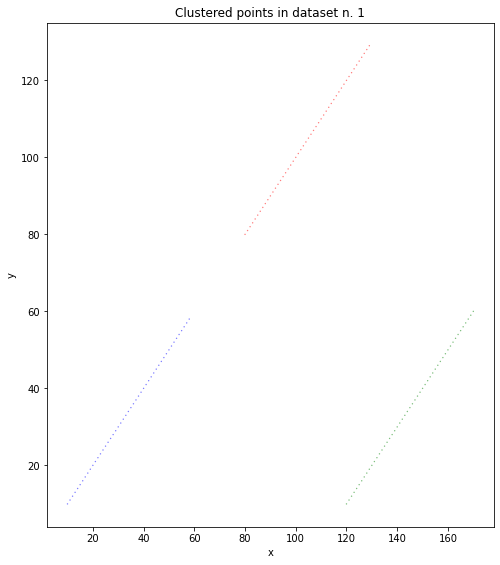

In [50]:
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(8,8))

ax = fig.add_subplot(111)
fig.subplots_adjust(top=1)
ax.set_title('Clustered points in dataset n. 1')

ax.set_xlabel('x')
ax.set_ylabel('y')

# set the list of colors to be selected when plotting the different clusters
color=['b','g','r','c','m','y','k','w']
    
#plot the dataset
for clu in range(k):
    # collect the sequence of cooordinates of the points in each given cluster (determined by clu)
    data_list_x = [data1[i,0] for i in range(n_samples1) if kmeans1.labels_[i]==clu]
    data_list_y = [data1[i,1] for i in range(n_samples1) if kmeans1.labels_[i]==clu]
    plt.scatter(data_list_x, data_list_y, s=2, edgecolors='none', c=color[clu], alpha=0.5)

plt.show()

In [51]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

def fit_Kmeans(k,data,n_samples):
    np.random.seed(5)
    kmeans = KMeans(n_clusters=k,random_state=0).fit(data)
    return kmeans

def plot_Kmeans(data,n_samples,kmeans):
    
    fig = plt.figure(figsize=(8,8))

    ax = fig.add_subplot(111)
    fig.subplots_adjust(top=1)
    ax.set_title('Clustered points in dataset')

    ax.set_xlabel('x')
    ax.set_ylabel('y')

    # set the list of colors to be selected when plotting the different clusters
    color=['b','g','r','c','m','y','k','w']
        
    #plot the dataset
    for clu in range(k):
        # collect the sequence of cooordinates of the points in each given cluster (determined by clu)
        data_list_x = [data[i,0] for i in range(n_samples) if kmeans.labels_[i]==clu]
        data_list_y = [data[i,1] for i in range(n_samples) if kmeans.labels_[i]==clu]
        plt.scatter(data_list_x, data_list_y, s=2, edgecolors='none', c=color[clu], alpha=0.5)

    plt.show()

In the following cell I propose you to perform clustering with K-means on dataset2.

In [52]:
import csv
import sys
from os.path import join

import numpy as np
 
def load_data(file_path, file_name):
   with open(join(file_path, file_name)) as csv_file:
       data_file = csv.reader(csv_file,delimiter=',')
       temp1 = next(data_file)
       n_samples = int(temp1[0])
       n_features = int(temp1[1])
       temp2 = next(data_file)
       feature_names = np.array(temp2[:n_features])

       data_list = [iter for iter in data_file]
               
       data = np.asarray(data_list, dtype=np.float64)                  
       
   return(data,feature_names,n_samples,n_features)

# The main program reads the input file containing the dataset
# file_path is the file path where the file with the data to be read are located
# we assume the file contains an example per line
# each example is a list of real values separated by a comma (csv format)
# The first line of the file contains the heading with:
# N_samples,n_features,
# The second line contains the feature names separated by a comma   


#file_path="~/meo/Documents/Didattica/Laboratorio-15-16-Jupyter/"
file_path="./Datasets"
# all the three datasets contain data points on (x,y) 
file_name2="dataset-DBSCAN.csv"

data2,feature_names2,n_samples2,n_features2 = load_data(file_path, file_name2)

k=3
kmeans2 = fit_Kmeans(k,data2,n_samples2)

In the following you have to plot clustering results on dataset2.

**Answer:** 
how do you explain what it happens?

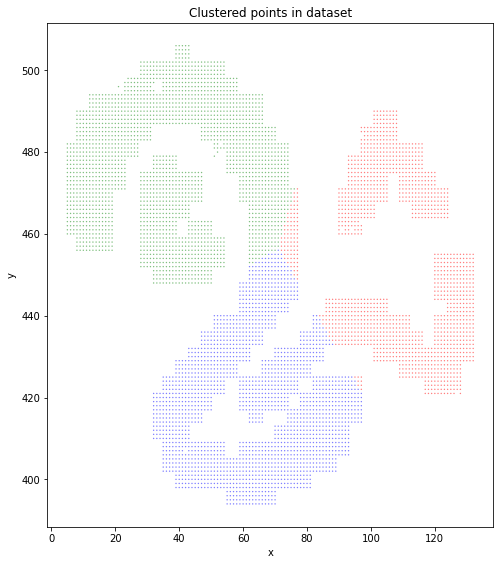

In [53]:
plot_Kmeans(data2,n_samples2,kmeans2)
# esce così perchè sta calcolando dei poligoni di voronoi, ecco perchè non clusterizza bene. i cluster sono molto densi perchè usa i centroidi

In the following cell I propose you to perform clustering with K-means on the dataset3.

In [54]:
import csv
import sys
from os.path import join

import numpy as np
 
def load_data(file_path, file_name):
   with open(join(file_path, file_name)) as csv_file:
       data_file = csv.reader(csv_file,delimiter=',')
       temp1 = next(data_file)
       n_samples = int(temp1[0])
       n_features = int(temp1[1])
       temp2 = next(data_file)
       feature_names = np.array(temp2[:n_features])

       data_list = [iter for iter in data_file]
               
       data = np.asarray(data_list, dtype=np.float64)                  
       
   return(data,feature_names,n_samples,n_features)

# The main program reads the input file containing the dataset
# file_path is the file path where the file with the data to be read are located
# we assume the file contains an example per line
# each example is a list of real values separated by a comma (csv format)
# The first line of the file contains the heading with:
# N_samples,n_features,
# The second line contains the feature names separated by a comma   


#file_path="~/meo/Documents/Didattica/Laboratorio-15-16-Jupyter/"
file_path="./Datasets"
# all the three datasets contain data points on (x,y) 
file_name3="CURE-complete.csv"

data3,feature_names3,n_samples3,n_features3 = load_data(file_path, file_name3)

k=5
kmeans3 = fit_Kmeans(k,data3,n_samples3)

In the following cell, I propose you to plot clustering results on dataset3.

**Answer:** 
how do you explain what it happens?

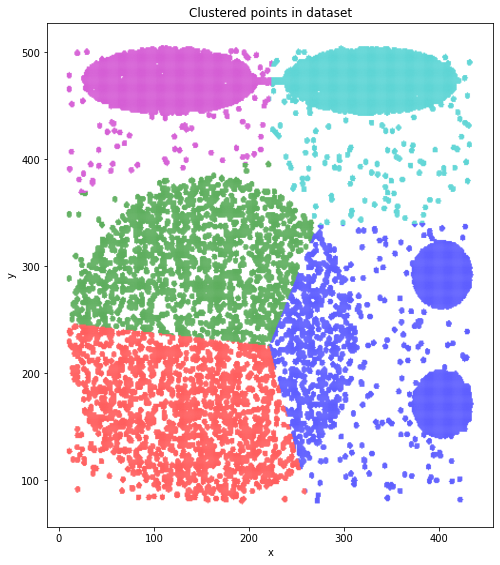

In [55]:
plot_Kmeans(data3,n_samples3,kmeans3)
# esce così perchè sta calcolando dei poligoni di voronoi, ecco perchè non clusterizza bene. i cluster sono più simili a cerchi

In the following cells I propose you to write a program that computes with a statistical measure of your choice a quantitative evaluation of clusters in the three datasets.

**Note:**
It is advisable to execute K-means a certain number of times (let us try 10 times) and then select the clustering solution that gives the best value of the evaluation measure.

In [56]:
import scipy.spatial.distance as distance
from sklearn.metrics import silhouette_score
# COHESION
def calculate_WSSE(k,kmeans,data,n_samples):
    wsse = 0
    for i in range(k):
        m = kmeans.cluster_centers_[i]
        for j in range(n_samples):
            if kmeans.labels_[j] == i:
                wsse+= distance.minkowski(data[j],m,2)
    return wsse

# SEPARATION
def calculate_BSSE(k,kmeans,data,n_samples):
    bsse = 0
    m = np.array([np.sum(data[:,0]) / n_samples,np.sum(data[:,1]) / n_samples])
    for i in range(k):
        mi = kmeans.cluster_centers_[i]
        size_of_cluster = np.count_nonzero(kmeans.labels_ == i)        
        for j in range(n_samples):
            if kmeans.labels_[j] == i:
                bsse+= distance.minkowski(m,mi,2)
    return bsse

#We want to maximise BSEE and MINIMIZE WSEE
def calculate_BSEE_AND_WSEE(data,k,n_samples,kmeans):
    wsse = calculate_WSSE(k,kmeans,data,n_samples)
    bsse = calculate_BSSE(k,kmeans,data,n_samples)
    print("WSSE: " , wsse," BSSE: ",bsse)
    return bsse,wsse

def calculate_silhouettes(data,kmeans):
    silhouette_avg = silhouette_score(data, kmeans.labels_)
    print("SILHOUETTES AVG: ", silhouette_avg)
    return silhouette_avg


calculate_BSEE_AND_WSEE(data1,3,n_samples1,kmeans1)
calculate_BSEE_AND_WSEE(data2,3,n_samples2,kmeans2)
calculate_BSEE_AND_WSEE(data3,3,n_samples3,kmeans3)


WSSE:  2651.6504294495535  BSSE:  8390.94170825951
WSSE:  135579.78550700235  BSSE:  222235.3461847385
WSSE:  4684077.706811259  BSSE:  7422523.942267583


(7422523.942267583, 4684077.706811259)

As already done with classification by k-nn, plot in the cell below the quantitative measure of your choice (used above) with respect to an increasing value of k (the number of clusters) so that the best value of k can be selected.

k neighbors=1
WSSE:  8673.480013993762  BSSE:  1.9184653865522705e-11
k neighbors=2
WSSE:  5373.498040219478  BSSE:  6440.235512215405
k neighbors=3
WSSE:  2651.6504294495535  BSSE:  8390.94170825951
k neighbors=4
WSSE:  2192.0310216782973  BSSE:  8521.986114163536


best k=4
best WSSE=2192.0310216782973
best BSEE= 8521.986114163536




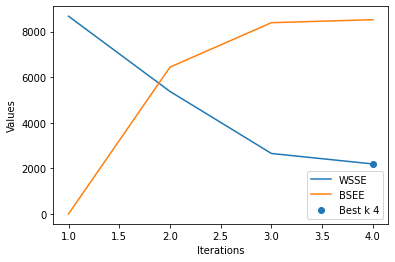

In [57]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from scipy.interpolate import interp1d

def plot_best_eval(wsse,bsee,best_k,bestEval):
    plt.figure()
    wsse=np.array(wsse)
    bsse=np.array(bsee)
    x=np.arange(1,it)
    plt.plot(x,bsee,label="WSSE")
    plt.plot(x,wsse,label="BSEE")
    plt.xlabel("Iterations")
    plt.ylabel("Values")
    plt.scatter(best_k,bestEval,label="Best k "+str(best_k))
    plt.legend()
    plt.show()

def eval_Kmeans(data,n_samples,iterations):
    best_k=0
    bestEval=float("Inf")
    best_k=0
    wsse=[]
    bsse=[]
    Sum_of_squared_distances = []
    for k in np.arange(1,iterations):
        print("k neighbors="+str(k))
        kmeans = fit_Kmeans(k,data,n_samples)
        _b,_w = calculate_BSEE_AND_WSEE(data,k,n_samples,kmeans)
        const=_w+_b
        if(_w <= bestEval):
            bestEval = _w
            best_k = k
        bsse.append(_b)
        wsse.append(_w)
    print("\n")
    print("best k="+str(best_k))
    print("best WSSE="+str(bestEval))
    print("best BSEE=",bsse[best_k-1])   
    print("\n")
    return bsse,wsse,best_k,bestEval
        
it = 5
bsse,wsse,best_k,bestEval = eval_Kmeans(data1,n_samples1,it)
plot_best_eval(bsse,wsse,best_k,bestEval)

In the following cell I propose you to run DBSCAN, instead, on one of the last two datasets: either dataset2 or dataset3. 

At the beginning try using a pair of Minpts and Eps of your choice.

**Note:**
If the data is too big, **sample it random, using a factor of 0.1.**

Estimated number of clusters: 6
Estimated number of noise points: 114
Estimated number of core points: 4978
Estimated number of border points: 6004


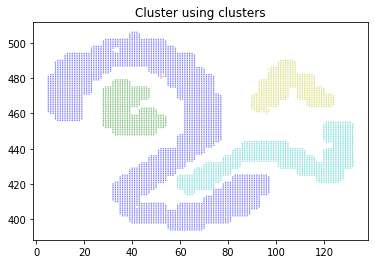

In [58]:
from sklearn.cluster import DBSCAN
from sklearn import metrics
import matplotlib.pyplot as plt

def plot_dbscan(db,data,n_samples):
    plt.figure()
    plt.title("Cluster using clusters")
    # set the list of colors to be selected when plotting the different clusters
    color=['b','g','r','c','m','y','k','w']
        
    #plot the dataset
    k = len(set(db.labels_)) - (1 if -1 in db.labels_ else 0)
    for clu in range(k):
        # collect the sequence of cooordinates of the points in each given cluster (determined by clu)
        data_list_x = [data[i,0] for i in range(n_samples) if db.labels_[i]==clu]
        data_list_y = [data[i,1] for i in range(n_samples) if db.labels_[i]==clu]
        plt.scatter(data_list_x, data_list_y, s=2, edgecolors='none', c=color[clu], alpha=0.5)

    plt.show()



eps = 1
min_pts = 5
db = DBSCAN(eps=eps, min_samples=min_pts).fit(data2)

labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print('Estimated number of core points: %d' % len(db.core_sample_indices_))
print('Estimated number of border points: %d' % (len(labels)-n_noise_))

plot_dbscan(db,data2,n_samples2)



In the following cell I propose you to: 

1.   Set *Minpts* to a number (say **10**).
2.   Compute the **reachability distance** of the **10-th nearest neighbour ** for each data-point.
3. Sort the set of reachability distances you obtained in an increasing way.
4. Plot the sorted reachability distances
5. Find the **elbow** of the diagram => it gives the eps value combined with Minpts=10.
6. Try this combined pair of parameters on the dataset you chose, with DBSCAN.

In [59]:
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
from kneed import KneeLocator

def find_all_distances_of_10th_nearesth(data,k):
    nbrs = NearestNeighbors(n_neighbors=k).fit(data)
    distances, indices = nbrs.kneighbors(data)
    all_distances = np.sort(distances[:,k-1])
    elbow = np.around(plot_distances(all_distances),1)
    print("BEST EPS: ", elbow , " FOR K = " , k)
    return elbow

def plot_distances(distances):
    plt.figure()
    plt.title("DISTANCE IN DATASET")
    plt.plot(np.arange(len(distances+1)),distances)
    plt.xlabel("POINTS")
    plt.ylabel("DISTANCE")
    # find elbow of distances
    kn = KneeLocator(distances,np.arange(len(distances+1)), direction='increasing')
    elbow = kn.knee
    plt.plot(np.where(distances == elbow)[0][0],kn.knee,"*")
    plt.show()
    return elbow
    


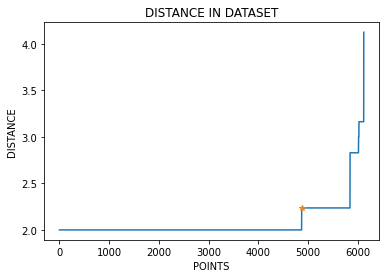

BEST EPS:  2.2  FOR K =  12


Estimated number of clusters: 4
Estimated number of noise points: 113
Estimated number of core points: 4868
Estimated number of border points: 6005




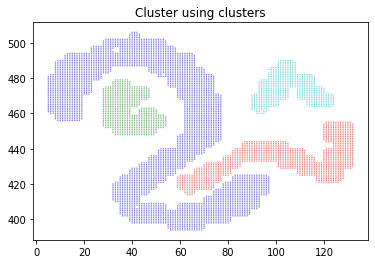

In [60]:
k = 12

elbow = find_all_distances_of_10th_nearesth(data2,k)
eps = elbow
min_pts = k

# REALLY THE BEST PARAMTERS IS EPS = 2.2 and MIN_PTS = 12
db = DBSCAN(eps=eps, min_samples=min_pts).fit(data2)

labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print("\n")
print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print('Estimated number of core points: %d' % len(db.core_sample_indices_))
print('Estimated number of border points: %d' % (len(labels)-n_noise_))
print("\n")

plot_dbscan(db,data2,n_samples2)